<a href="https://colab.research.google.com/github/tnthdrhks1/knu_machine_learning/blob/main/kangwon_test.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [5]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression, SGDClassifier
from glob import glob
from PIL import Image, ImageDraw

In [6]:
from google.colab import drive
drive.mount('/gdrive', force_remount=True)

Mounted at /gdrive


In [7]:
video_path = glob('/gdrive/My Drive/kangwon_test/*')[0]
text_path = glob('/gdrive/My Drive/kangwon_test/*')[1]
video_path, text_path

('/gdrive/My Drive/kangwon_test/08-11-2019-1-1.MP4',
 '/gdrive/My Drive/kangwon_test/08-11-2019-1-1.txt')

In [8]:
df = pd.read_csv(text_path, header=None)
df

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25
0,3,-1,2071.6,975.06,96.16,221.94,-1,-1.000,-1.000,-1.000,0,4,2,0,3,0,1,1,0,0,3,8,2,0,6,0
1,3,205,1806.0,956.88,81.97,250.24,1,2.295,-32.574,-11.471,0,2,2,0,3,0,1,0,0,2,3,8,0,0,1,0
2,3,180,1904.5,967.00,87.08,245.00,1,2.295,-32.574,-11.471,0,2,2,0,3,0,1,0,0,2,3,8,0,4,1,0
3,3,-1,1775.4,941.00,54.12,222.00,-1,-1.000,-1.000,-1.000,0,4,2,1,3,0,1,1,1,2,3,8,2,4,6,0
4,4,-1,2071.3,975.19,96.17,221.81,-1,-1.000,-1.000,-1.000,0,4,2,0,3,0,1,1,0,0,3,8,2,0,6,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12559,1325,208,3309.0,1122.20,112.91,318.72,1,2.295,-32.574,-11.471,0,3,2,1,3,0,1,0,0,0,3,8,0,0,1,0
12560,1326,188,3046.7,2084.10,68.49,76.92,1,2.295,-32.574,-11.471,1,2,1,0,3,0,4,1,1,2,3,1,1,4,1,0
12561,1326,208,3399.0,1133.20,116.73,324.93,1,2.295,-32.574,-11.471,0,3,2,1,3,0,1,0,0,0,3,8,0,0,1,0
12562,1327,188,3114.8,2101.10,53.67,60.26,1,2.295,-32.574,-11.471,1,2,1,0,3,0,4,1,1,2,3,1,1,4,1,0


In [9]:
cond = df[0]%30 == 0
df_hot = df[cond]
df_hot

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25
97,30,-1,2112.2,962.78,85.77,223.13,-1,-1.000,-1.000,-1.000,0,4,2,0,3,0,1,1,0,0,3,8,2,0,6,0
98,30,205,1808.3,977.44,88.83,268.32,1,2.295,-32.574,-11.471,0,2,2,0,3,0,1,0,0,2,3,8,0,0,1,0
99,30,180,1897.9,980.44,90.64,270.37,1,2.295,-32.574,-11.471,0,2,2,0,3,0,1,0,0,2,3,8,0,4,1,0
100,30,175,1944.9,951.96,59.10,206.82,1,2.295,-32.574,-11.471,0,2,1,0,3,0,1,0,0,0,3,8,2,4,1,0
101,30,-1,1691.9,948.31,66.50,173.17,-1,-1.000,-1.000,-1.000,1,3,2,1,3,0,4,1,1,2,3,6,6,4,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12424,1290,-1,3341.4,1666.20,240.97,493.98,-1,-1.000,-1.000,-1.000,0,2,2,1,3,0,1,1,0,2,3,0,0,4,1,0
12425,1290,151,1748.9,911.80,61.30,163.41,1,2.295,-32.574,-11.471,0,4,1,1,3,0,1,1,1,2,3,8,0,0,6,0
12543,1320,188,2631.6,1971.20,122.97,189.86,1,2.295,-32.574,-11.471,1,2,1,0,3,0,4,1,1,2,3,1,1,4,1,0
12544,1320,208,2931.6,1084.90,99.03,296.12,1,2.295,-32.574,-11.471,0,3,2,1,3,0,1,0,0,0,3,8,0,0,1,0


In [10]:
import cv2

In [11]:
img_list = [] #영상 44초

vidcap = cv2.VideoCapture(video_path)
success,image = vidcap.read()
count = 0
success = True
while success:
  count += 1
  if count%30 == 0:
    if True: #색감이 이상할때 
      B, G, R = np.split(image, 3, axis=-1)
      image = np.concatenate((R, G, B), -1)

    img_list.append(image)
  success,image = vidcap.read()

img_list = np.array(img_list)
img_list.shape

(44, 2160, 3840, 3)

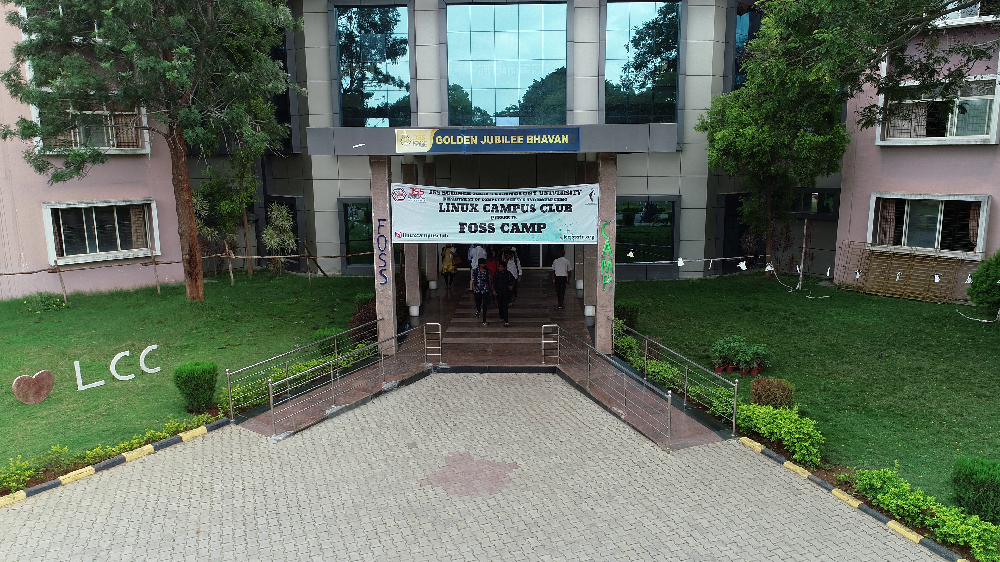

In [12]:
img_sample = Image.fromarray(img_list[0])
img_sample

In [13]:
df_sample = df_hot[df_hot[0] == 30]
len(df_sample)

5

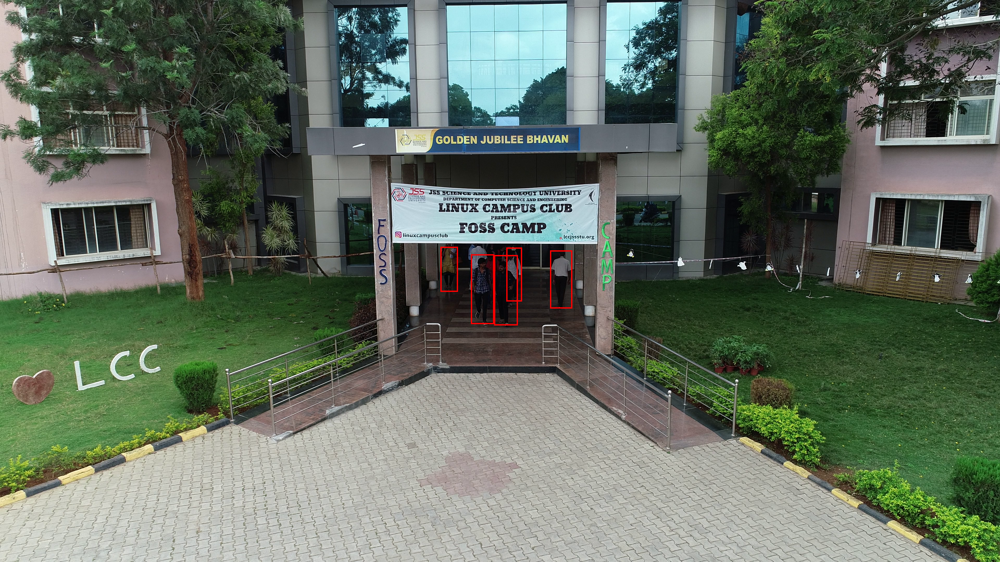

In [14]:
for i in range (len(df_sample)):
  x = df_sample.iloc[i][2]
  y = df_sample.iloc[i][3]
  h = df_sample.iloc[i][4]
  w = df_sample.iloc[i][5]

  draw = ImageDraw.Draw(img_sample)
  draw.rectangle((x,y,x+h,y+w),fill=None, outline=(255,0,0), width=5)

img_sample

# 박스

In [15]:
df_real = df_hot[df_hot[0]<330]
df_real

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25
97,30,-1,2112.2,962.78,85.77,223.13,-1,-1.000,-1.000,-1.000,0,4,2,0,3,0,1,1,0,0,3,8,2,0,6,0
98,30,205,1808.3,977.44,88.83,268.32,1,2.295,-32.574,-11.471,0,2,2,0,3,0,1,0,0,2,3,8,0,0,1,0
99,30,180,1897.9,980.44,90.64,270.37,1,2.295,-32.574,-11.471,0,2,2,0,3,0,1,0,0,2,3,8,0,4,1,0
100,30,175,1944.9,951.96,59.10,206.82,1,2.295,-32.574,-11.471,0,2,1,0,3,0,1,0,0,0,3,8,2,4,1,0
101,30,-1,1691.9,948.31,66.50,173.17,-1,-1.000,-1.000,-1.000,1,3,2,1,3,0,4,1,1,2,3,6,6,4,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2135,300,206,1720.2,1271.60,111.77,321.98,1,2.295,-32.574,-11.471,1,2,1,0,3,0,1,1,1,0,3,1,1,4,1,0
2136,300,165,1835.4,1272.30,98.64,303.92,1,2.295,-32.574,-11.471,1,2,1,1,3,0,3,1,1,2,3,1,1,4,1,0
2137,300,196,1939.5,1296.10,102.47,277.55,1,2.295,-32.574,-11.471,1,2,1,0,3,0,4,1,1,2,3,1,1,4,1,0
2138,300,207,1970.3,1014.00,98.36,313.72,1,2.295,-32.574,-11.471,0,2,2,1,3,0,1,0,0,2,3,0,0,0,1,0


In [16]:
img_draw = [] # 박스 친 사진들이 들어갈 리스트
img_before = []

for i in range (len(df_real)):

  frame = df_real.iloc[i][0] / 30
  img_np = img_list[int((frame/30)-1)]

  x = df_real.iloc[i][2]
  y = df_real.iloc[i][3]
  h = df_real.iloc[i][4]
  w = df_real.iloc[i][5]
  
  if df_real.iloc[i][0] != df_real.iloc[i-1][0]:
    img = Image.fromarray(img_np)
    draw = ImageDraw.Draw(img)
    draw.rectangle((x,y,x+h,y+w),fill=None, outline=(255,0,0), width=5)
    img_draw.append(img)
    img_before.append(img)

  else:
    img = img_before[-1]
    draw = ImageDraw.Draw(img)
    draw.rectangle((x,y,x+h,y+w),fill=None, outline=(255,0,0), width=5)
    img_before.append(img)

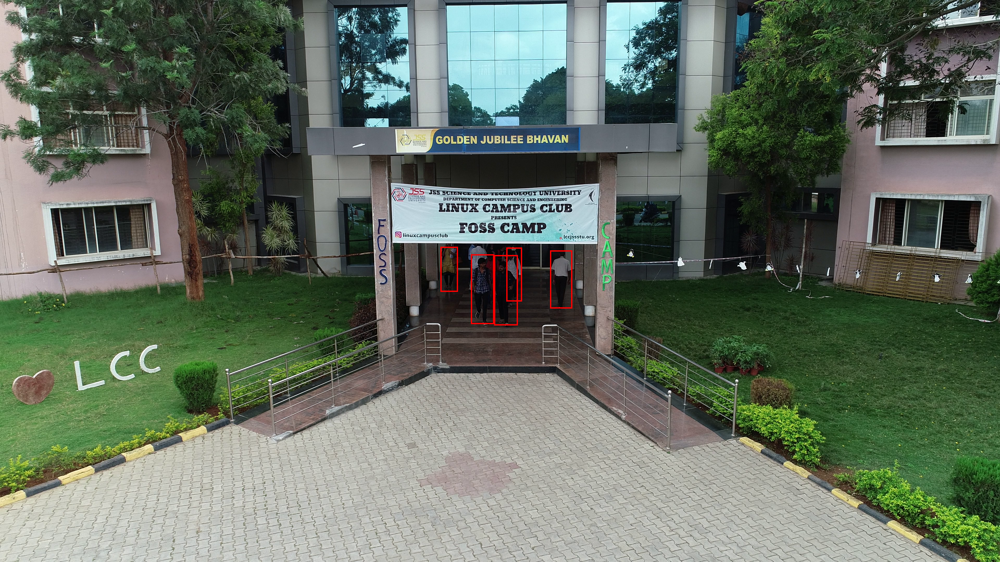

In [17]:
img_draw[0]

# crop

In [18]:
img_crop = []
id = []
for i in range (len(df_real)):

  frame = df_real.iloc[i][0] / 30
  img_np = img_list[int((frame/30)-1)]

  x = df_real.iloc[i][2]
  y = df_real.iloc[i][3]
  h = df_real.iloc[i][4]
  w = df_real.iloc[i][5]
  cls = df_real.iloc[i][1]
  id.append(cls)

  img = Image.fromarray(img_np)
  img = img.crop((x,y,x+h,y+w)).resize((86,223))
  img = np.array(img)

  img_crop.append(img)
img_crop = np.array(img_crop)
x = img_crop
id = np.array(id)
y = id

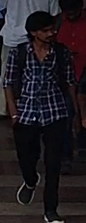

In [19]:
Image.fromarray(x[1])

In [20]:
x_2d = x.reshape(-1,223*86*3)
x.shape, x_2d.shape

((76, 223, 86, 3), (76, 57534))

In [21]:
y = y.astype(np.int)

In [22]:
y_ = []
for i in y:
  if i == -1:
    y_.append(1)
  else:
    y_.append(i)
y_

[1,
 205,
 180,
 175,
 1,
 1,
 205,
 180,
 175,
 1,
 1,
 1,
 205,
 180,
 1,
 184,
 1,
 205,
 180,
 1,
 184,
 204,
 175,
 205,
 180,
 1,
 184,
 204,
 175,
 206,
 205,
 180,
 1,
 184,
 204,
 175,
 206,
 205,
 180,
 1,
 184,
 204,
 175,
 206,
 165,
 196,
 205,
 180,
 1,
 184,
 204,
 175,
 206,
 165,
 196,
 207,
 205,
 180,
 1,
 184,
 204,
 175,
 206,
 165,
 196,
 207,
 205,
 1,
 184,
 204,
 175,
 206,
 165,
 196,
 207,
 208]

In [23]:
y = np.array(y_).astype(np.int)

In [24]:
model = SGDClassifier().fit(x_2d,y)
model.score(x_2d,y)

0.7894736842105263

In [25]:
np.unique(y)

array([  1, 165, 175, 180, 184, 196, 204, 205, 206, 207, 208])

In [26]:
from tensorflow import keras

# cnn

In [27]:
model = keras.Sequential()
model.add(keras.layers.Input(shape=(223, 86, 3))) 

model.add(keras.layers.Conv2D(100, kernel_size=(5, 5), padding='SAME', activation='relu'))
model.add(keras.layers.MaxPool2D(pool_size=(2, 2), strides=2, padding='SAME'))

model.add(keras.layers.Flatten())
model.add(keras.layers.Dense(209, activation='softmax'))
loss = keras.losses.SparseCategoricalCrossentropy()

model.compile(loss=loss, metrics=['accuracy'])
history = model.fit(x,y,epochs=100)

Epoch 1/100
3/3 [==============================] - 7s 99ms/step - loss: 298.2330 - accuracy: 0.0734
Epoch 2/100
3/3 [==============================] - 0s 60ms/step - loss: 455.2134 - accuracy: 0.1571
Epoch 3/100
3/3 [==============================] - 0s 61ms/step - loss: 27.4309 - accuracy: 0.4451
Epoch 4/100
3/3 [==============================] - 0s 62ms/step - loss: 103.9179 - accuracy: 0.4280
Epoch 5/100
3/3 [==============================] - 0s 60ms/step - loss: 22.6714 - accuracy: 0.7017
Epoch 6/100
3/3 [==============================] - 0s 60ms/step - loss: 31.5664 - accuracy: 0.6386
Epoch 7/100
3/3 [==============================] - 0s 63ms/step - loss: 48.6338 - accuracy: 0.4870
Epoch 8/100
3/3 [==============================] - 0s 62ms/step - loss: 10.4432 - accuracy: 0.8090
Epoch 9/100
3/3 [==============================] - 0s 60ms/step - loss: 12.6451 - accuracy: 0.9056
Epoch 10/100
3/3 [==============================] - 0s 63ms/step - loss: 7.9704 - accuracy: 0.8627
Epoch 1

In [28]:
model.evaluate(x,y)

3/3 [==============================] - 0s 8ms/step - loss: 1.5685e-09 - accuracy: 1.0000


[1.5685431842271669e-09, 1.0]